## Background and Project Description

In recent years a rising number of Airbnbs occupy Edinburgh city. In the analysis below I try to get a better understanding of the Airbnb landscape in Edinburgh. To achieve this, insights on how Airbnbs populate the city were created.

In addition, using the data available, a linear model was built to estimate the price of an Airbnb, given a number of key features.

Finally, the hypothesis that the minimum night requirement for private rooms is lower compared to entire homes/apartments was tested.

## Step 0: Setting up

In [1]:
import pandas as pd
import requests
import folium
from folium.plugins import MarkerCluster
import matplotlib.pyplot as plt
import matplotlib as mpl
import numpy as np
import seaborn as sns
import json
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import OneHotEncoder
import pickle
from sklearn.pipeline import Pipeline
from sklearn.linear_model import LinearRegression
from sklearn.metrics import r2_score
import math
%matplotlib inline

## Step 1: Reading & Cleaning Data

### Step 1a: Reading Data
We use pandas to read the data into a pandas data frame.

In [2]:
df0 = pd.read_csv('Airbnb.csv')
df0.head(3)
df0.shape

(6425, 18)

### Step 1b: Cleaning Data

A quick look at the data reveals that it is hard to identify duplicates. The reason is that there is no unique identifier for each property or room. Even properties with the same name, description and neighbourhood cannot be safely identified as duplicates as there could be multiple rooms or apartments with the same characteristics in the same property which are advertised separately. 

One property which has a price of zero was identified. This is not considered reasonable therefore the record for this property has been removed.

In addition, I decided to transform the 'bathrooms_text' feature from text to float as it is more useful for my analysis. For example, if a property has "1.5 baths" this will change to 1.5. Moreover, if a property has shared bathrooms this will change to zero. Finally, all records for properties that do not provide bathrooms_text data (e.g. the value for this feature is 'NaN') have been removed.

In [3]:
# drop property where price is zero
df0.drop( df0[df0['price'] == 0 ].index , inplace=True)

In [4]:
# drop properties where bathroom details are not provided
df0.drop( df0[df0['bathrooms_text'].isnull()].index , inplace=True)

In [5]:
def textToFloat(x):
    y = x.lower()
    if 'shared' in y:
        return 0
    elif 'half-bath'in y:
        return 0.5
    else:
        words = y.split()
        return float(words[0])

In [6]:
# convert number of bathrooms from text to float
df0['bathrooms_number'] = df0['bathrooms_text'].map(lambda x: textToFloat(x))

## Step 2: Derive new Features

For the purpose of this analysis four additional features were created:

* Accomodation Capacity - Categorical Ordinal
* Price Per Person - Quantitative Continuous
* Affordability - Categorical Ordinal
* Bathrooms per Person - Quantitative Continuous
* Number of amenities - Quantitative Discrete

To derive these features, three existing features were used: the number of people a property can accommodate, the price per night and the list of amenities for each property. 

Accomodation Capacity is defined as 'SMALL' if the property can accommodate up to 4 guests, 'MEDIUM' if the property can accommodate between 5 and 10 guests and 'LARGE' for more than 10 guests.

Affordability is defined as 'CHEAP' if the price per person is less than £30, 'REASONABLE' if it is between £30 and £100 and 'EXPENSIVE' otherwise.

Price per person is calculated as the price per night divided by the number of guests a property can accommodate.

Bathroom per Person is calculated as the number of bathrooms in the property divided by the number of guests a property can accommodate.

Number of amenities is calculated as the length of the amenities list on each property.

In [7]:
# create new categorical feature
df0['accomodation_capacity'] = ['SMALL' if x<=4 else 'MEDIUM' if x>4 and x<=10 else 'LARGE'for x in df0['accommodates']]

In [8]:
# create new categorical feature
df0['affordability'] = ['CHEAP' if x<=30 else 'REASONABLE' if x>30 and x<=100 else 'EXPENSIVE'for x in (df0['price']/df0['accommodates'])]

In [9]:
#create new quantitative feature
df0['price_per_person'] = [x for x in (df0['price']/df0['accommodates'])]

In [10]:
#create new quantitative feature
df0['bathroom_per_person'] = [x for x in (df0['bathrooms_number']/df0['accommodates'])]

In [11]:
df0['number_of_amenities'] = [len(json.loads(x)) for x in df0['amenities']]

In [12]:
df0.head(3)

,id,name,description,host_is_superhost,neighbourhood,latitude,longitude,property_type,room_type,accommodates,...,price,minimum_nights,maximum_nights,distance_from_centre,bathrooms_number,accomodation_capacity,affordability,price_per_person,bathroom_per_person,number_of_amenities
0,1,Georgian Boutique Apt City Centre,"Stunning, impeccably refurbished spacious grou...",True,"Old Town, Princes Street and Leith Street",55.95689,-3.18768,Entire apartment,Entire home/apt,2,...,60,3,30,1.19,1.0,SMALL,CHEAP,30.0,0.50,30
1,2,Edinburgh Holiday Let,Brunstane - Daiches Braes (close to Portobello...,False,Joppa,55.94215,-3.09640,Entire apartment,Entire home/apt,2,...,46,4,120,6.48,1.5,SMALL,CHEAP,23.0,0.75,30
2,3,"Very Spacious, Well Lit, Double Room, Very Cen...","Imagine living in a beautiful, well lit, very ...",False,Marchmont East and Sciennes,55.93812,-3.19423,Private room in apartment,Private room,2,...,45,2,10,1.22,0.0,SMALL,CHEAP,22.5,0.00,23


## Step 3: Visualization

I used Python's Folium package to visualize the data as markers on a map. Adding the individual points to MarkerClusters allows us to summarize the symbols into groups if too many symbols are in the same region. Creating a separate cluster for each category allows us to use the LayerControl option to toogle each of the categories individually. Folium does not natively display on GitHub. You can look at the notebook including the interactive [here](https://nbviewer.jupyter.org/github/StamatisTiniakos/edinburgh-airbnb-analysis/blob/master/airbnb_edinburgh_analysis.ipynb).

### Step 3a: Properties by Room Type

In [13]:
# central coordinates of Edinburgh
EDI_COORDINATES = (55.953251, -3.188267)
  
# create empty map zoomed in on Edinburgh
map = folium.Map(location=EDI_COORDINATES, zoom_start=12)

#tooltip
tooltip_entire_home = "Entire Home"
tooltip_private_room = "Private Room"
tooltip_hotel_room = "Hotel Room"
tooltip_shared_room = "Shared Room"

# add one markercluster per type to allow for individual toggling
entire_home = MarkerCluster(name='Entire home/apt').add_to(map)
private_room = MarkerCluster(name='Private room').add_to(map)
hotel_room = MarkerCluster(name='Hotel room').add_to(map)
shared_room = MarkerCluster(name='Shared room').add_to(map)

# add entire homes to the map
for prop in df0[df0.room_type == 'Entire home/apt'].iterrows():
    folium.Marker(location=[float(prop[1]['latitude']), float(prop[1]['longitude'])], 
                  popup="No of Guests: "+ str(prop[1]['accommodates']),tooltip = tooltip_entire_home,
                 icon=folium.Icon(color='gray', icon_color='white',icon='home', angle=0, prefix='fa')).add_to(entire_home)
    
# add private rooms to the map
for prop in df0[df0.room_type == 'Private room'].iterrows():
    folium.Marker(location=[float(prop[1]['latitude']), float(prop[1]['longitude'])], 
                  popup="No of Guests: " + str(prop[1]['accommodates']),tooltip = tooltip_private_room,
                 icon=folium.Icon(color='purple',icon_color='black',icon='bed', angle=0, prefix='fa')).add_to(private_room)
    
# add hotel rooms to the map
for prop in df0[df0.room_type == 'Hotel room'].iterrows():
    folium.Marker(location=[float(prop[1]['latitude']), float(prop[1]['longitude'])], 
                  popup="No of Guests: " + str(prop[1]['accommodates']),tooltip = tooltip_hotel_room,
                 icon=folium.Icon(color='white',icon_color='black', icon='cloud', prefix='fa')).add_to(hotel_room)

# add hotel rooms to the map
for prop in df0[df0.room_type == 'Shared room'].iterrows():
    folium.Marker(location=[float(prop[1]['latitude']), float(prop[1]['longitude'])], 
                  popup="No of Guests: "+ str(prop[1]['accommodates']),tooltip = tooltip_shared_room,
                 icon=folium.Icon(color='red',icon_color='white', icon='leaf')).add_to(shared_room)
    
# enable toggling of data points
folium.LayerControl().add_to(map)    

map.save('room_type.html')
display(map)

### Step 3b: Properties by Accomodation Capacity

In [14]:
# central coordinates of Edinburgh
EDI_COORDINATES = (55.953251, -3.188267)
  
# create empty map zoomed in on Edinburgh
map_acc_capacity = folium.Map(location=EDI_COORDINATES, zoom_start=12)

#tooltip
tooltip_small = "Small Capacity"
tooltip_medium = "Medium Capacity"
tooltip_large = "Large Capacity"

# add one markercluster per type to allow for individual toggling
small = MarkerCluster(name='Small Capacity').add_to(map_acc_capacity)
medium = MarkerCluster(name='Medium Capacity').add_to(map_acc_capacity)
large = MarkerCluster(name='Large Capacity').add_to(map_acc_capacity)

# add properties with small capacity to the map
for prop in df0[df0.accomodation_capacity == 'SMALL'].iterrows():
    folium.Marker(location=[float(prop[1]['latitude']), float(prop[1]['longitude'])], 
                  popup="No of Guests: "+ str(prop[1]['accommodates']),tooltip = tooltip_small,
                 icon=folium.Icon(color='gray', icon_color='white',icon='battery-empty', angle=0, prefix='fa')).add_to(small)
    
# add properties with medium capacity to the map
for prop in df0[df0.accomodation_capacity == 'MEDIUM'].iterrows():
    folium.Marker(location=[float(prop[1]['latitude']), float(prop[1]['longitude'])], 
                  popup="No of Guests: " + str(prop[1]['accommodates']),tooltip = tooltip_medium,
                 icon=folium.Icon(color='purple',icon_color='black',icon='battery-half', angle=0, prefix='fa')).add_to(medium)
    
# add properties with large capacity to the map
for prop in df0[df0.accomodation_capacity == 'LARGE'].iterrows():
    folium.Marker(location=[float(prop[1]['latitude']), float(prop[1]['longitude'])], 
                  popup="No of Guests: " + str(prop[1]['accommodates']),tooltip = tooltip_large,
                 icon=folium.Icon(color='white',icon_color='black', icon='battery-full', prefix='fa')).add_to(large)
    
# enable toggling of data points
folium.LayerControl().add_to(map_acc_capacity)    

map_acc_capacity.save('accomodation_capacity.html')
display(map_acc_capacity)

### Step 3c: Properties by Affordability

In [15]:
# central coordinates of Edinburgh
EDI_COORDINATES = (55.953251, -3.188267)
  
# create empty map zoomed in on Edinburgh
map_affordability = folium.Map(location=EDI_COORDINATES, zoom_start=12)

#tooltip
tooltip_small = "Cheap"
tooltip_medium = "Reasonable"
tooltip_large = "Expensive"

# add one markercluster per type to allow for individual toggling
cheap = MarkerCluster(name='Cheap').add_to(map_affordability)
reasonable = MarkerCluster(name='Reasonable').add_to(map_affordability)
expensive = MarkerCluster(name='Expensive').add_to(map_affordability)

# add cheap properties to the map
for prop in df0[df0.affordability == 'CHEAP'].iterrows():
    folium.Marker(location=[float(prop[1]['latitude']), float(prop[1]['longitude'])], 
                  popup="No of Guests: "+ str(prop[1]['accommodates']),tooltip = tooltip_small,
                 icon=folium.Icon(color='gray', icon_color='black',icon='star-half', angle=0, prefix='fa')).add_to(cheap)
    
# add reasonable priced properties to the map
for prop in df0[df0.affordability == 'REASONABLE'].iterrows():
    folium.Marker(location=[float(prop[1]['latitude']), float(prop[1]['longitude'])], 
                  popup="No of Guests: " + str(prop[1]['accommodates']),tooltip = tooltip_medium,
                 icon=folium.Icon(color='orange',icon_color='black', icon='balance-scale', prefix='fa')).add_to(reasonable)
    
# add expensive properties to the map
for prop in df0[df0.affordability == 'EXPENSIVE'].iterrows():
    folium.Marker(location=[float(prop[1]['latitude']), float(prop[1]['longitude'])], 
                  popup="No of Guests: " + str(prop[1]['accommodates']),tooltip = tooltip_large,
                 icon=folium.Icon(color='red',icon_color='black', icon='star', prefix='fa')).add_to(expensive)
    
# enable toggling of data points
folium.LayerControl().add_to(map_affordability)    

map_affordability.save('affordability.html')
display(map_affordability)

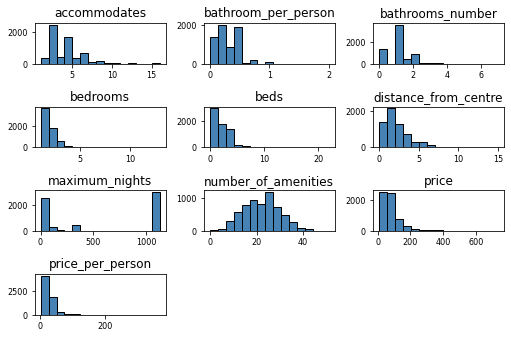

In [16]:
# the plots below give a good idea about the basic data distribution of the key features.
subset_attributes = ['accommodates','bedrooms','beds','bathroom_per_person','bathrooms_number','price_per_person','price','distance_from_centre','maximum_nights','number_of_amenities']
df1 = df0[subset_attributes]
df1.hist(bins=15, color='steelblue', edgecolor='black', linewidth=1.0,
           xlabelsize=8, ylabelsize=8, grid=False)    
plt.tight_layout(rect=(0, 0, 1.2, 1.2))

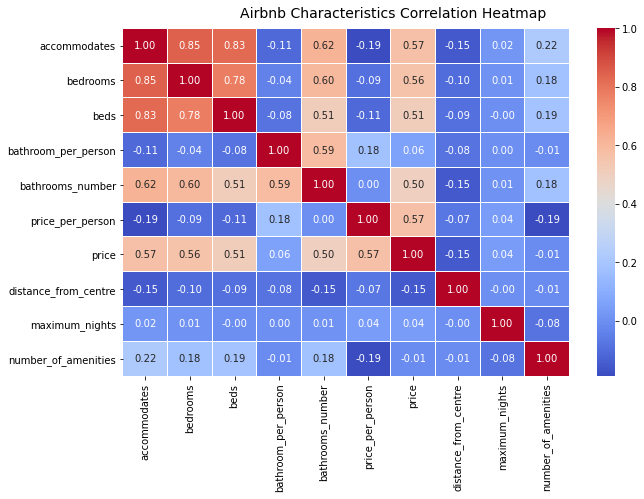

In [17]:
# Correlation Matrix Heatmap
f, ax = plt.subplots(figsize=(10, 6))
corr = df1.corr()
hm = sns.heatmap(round(corr,2), annot=True, ax=ax, cmap="coolwarm",fmt='.2f',
                 linewidths=.05)
f.subplots_adjust(top=0.93)
t= f.suptitle('Airbnb Characteristics Correlation Heatmap', fontsize=14)

In [18]:
df1.describe(include='all')

,accommodates,bedrooms,beds,bathroom_per_person,bathrooms_number,price_per_person,price,distance_from_centre,maximum_nights,number_of_amenities
count,6417.000000,6255.000000,6393.000000,6417.000000,6417.000000,6417.000000,6417.000000,6417.000000,6417.000000,6417.000000
mean,3.571139,1.608793,2.049585,0.305096,1.040439,27.028639,88.837775,2.293637,571.021661,22.145083
std,2.060788,0.893042,1.578132,0.225649,0.733214,19.853828,74.322367,1.874206,524.977985,7.988262
min,1.000000,1.000000,0.000000,0.000000,0.000000,2.833333,9.000000,0.030000,1.000000,0.000000
25%,2.000000,1.000000,1.000000,0.166667,1.000000,16.000000,45.000000,1.090000,30.000000,16.000000
50%,3.000000,1.000000,2.000000,0.250000,1.000000,22.500000,68.000000,1.790000,365.000000,22.000000
75%,4.000000,2.000000,3.000000,0.500000,1.000000,32.500000,100.000000,2.970000,1125.000000,28.000000
max,16.000000,13.000000,22.000000,2.000000,7.000000,367.000000,734.000000,15.010000,1125.000000,51.000000


## Step 4: Create a Predictive Model

A model was built to estimate the price of an Airbnb, given the following features:

* Type of accommodation (room_type) 
* Number of guests (accommodates)
* Number of bathrooms (from bathrooms_text). Please note that shared bathrooms are encoded as zero.
* Distance from city centre (distance_from_centre)

A linear regression model was chosen as it is the most explainable.

One Hot Encoding was used to represent the room_type categorical variable as binary vectors.

A pipeline was created for simplicity, it will make life easier when the model is used again in the future. The pipeline includes the encoding transformation of the categorical variable and the trained linear model. 

To avoid training the model again in the future the pipeline was saved on a file in binary format. This file can be loaded whenever needed.

In [19]:
subset_attributes_model = ['room_type','accommodates','bathrooms_number','distance_from_centre','price']

In [20]:
# create a new dataframe that includes only the features that are included in the model
df2 = df0[subset_attributes_model]

In [21]:
# create one hot encoding transformer
ct = ColumnTransformer(transformers=[('encoder',OneHotEncoder(),[0])],remainder='passthrough')

In [22]:
# Create a new dataframe that includes the new encoded features
Z = ct.fit_transform(df2)
df3 = pd.DataFrame(Z)
df3.columns = ['entire home/apt','hotel room','private room','shared room','accommodates', 'bathrooms_number', 'distance from center', 'price']

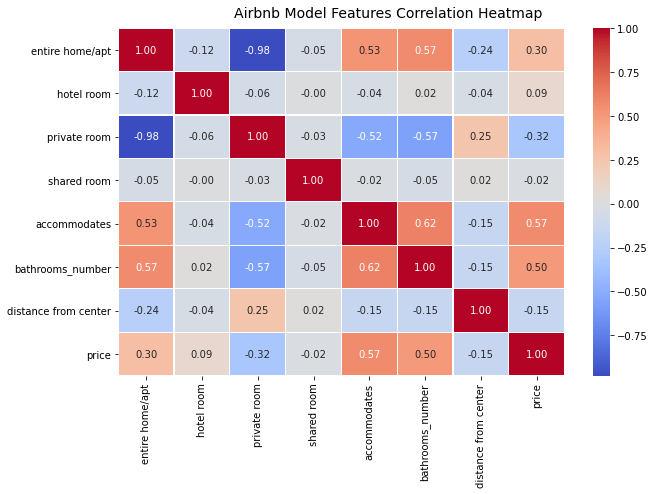

In [23]:
#Correlation Matrix Heatmap
f, ax = plt.subplots(figsize=(10, 6))
corr = df3.corr()
hm = sns.heatmap(round(corr,2), annot=True, ax=ax, cmap="coolwarm",fmt='.2f',
                 linewidths=.05)
f.subplots_adjust(top=0.93)
t= f.suptitle('Airbnb Model Features Correlation Heatmap', fontsize=14)

In [24]:
# separate the features from the target class
X = df2.iloc[:,:-1].values
Y = df2.iloc[:,-1].values

In [25]:
# encode the categorical feature
X = np.array(ct.fit_transform(X))

In [26]:
# split data in training and test sets
X_train, X_test , y_train, y_test = train_test_split(X,Y,test_size=0.2,random_state=0)

In [27]:
# train the model
regressor = LinearRegression()
regressor.fit(X_train, y_train)

LinearRegression()

In [28]:
# predict prices for the examples on the test dataset
y_pred = regressor.predict(X_test)

In [29]:
# model evaluation using r-squared
r2_score(y_test,y_pred)

0.30684377187901846

In [30]:
# model coefficients and intercept
print("coefficients: ",regressor.coef_)
print("Intercept: ",regressor.intercept_)

coefficients:  [-3.69276110e+12 -3.69276110e+12 -3.69276110e+12 -3.69276110e+12
  1.66669922e+01  2.79714355e+01 -2.88574219e+00]
Intercept:  3692761100258.078


In [31]:
# create a pipeline that includes both the encoding transformation and the trained model
linear_model = Pipeline([('encoding', ct),('lr', regressor)])

In [32]:
# save the model
filename = 'linear_regression.sav'
pickle.dump(linear_model, open(filename, 'wb'))

In [33]:
# Function that loads the model from disk and predicts the price of an airbnb
def predictAirbnbPrice(room_type,accomodates,bathooms,distance,model_filename):
    
    model = pickle.load(open(model_filename, 'rb'))
    characteristics = [room_type,accomodates,bathooms,distance]
    return model.predict([characteristics])[0]
    

In [34]:
# example of function usage
predictAirbnbPrice('Private room',2,0,1.22,'linear_regression.sav')

47.5810546875

## Step 5: Hypothesis Testing

**Question**: Someone makes the hypothesis that private rooms (room_type) have a lower minimum night
requirement (minimum_nights) compared to entire homes/apartments (room_type). Can you prove
or disprove the validity of this claim? 

**H0**: Minimum night requirement for private rooms is greater than or equal to entire homes/apartments.

**H1**: Minimum night requirement for private rooms is lower than entire homes/apartments.


In [35]:
# number of private rooms
private_home_count =  df0[df0['room_type']=='Private room']['minimum_nights'].count()

# average minimum nights for private rooms
private_home_mean =  df0[df0['room_type']=='Private room']['minimum_nights'].mean()

# standard deviation of minimum nights for private rooms
private_home_std = df0[df0['room_type']=='Private room']['minimum_nights'].std()

# average minimum nights for entire homes/appartments 
entire_home_mean =  df0[df0['room_type']=='Entire home/apt']['minimum_nights'].mean()

In [36]:
# standard deviation of sampling distribution

std_sampling_distribution = private_home_std/math.sqrt(private_home_count)
std_sampling_distribution

0.11717320208029734

In [37]:
z_score = (private_home_mean- entire_home_mean)/std_sampling_distribution
z_score

-4.057216836289199

At a significance level of 0.05 the critical value is z = -1.645. The private home minimum nights requirement mean has a z-score (-4.057) less than the critical value of -1.645. Thus, it is significant at the 0.05 level. The H0 hypothesis can be rejected at 0.05 level. In other words, the minimum night requirement for private rooms is lower than entire homes/apartments.